In [1]:
import torch
import torchvision
from torchvision import transforms, utils, models
from torchvision.io import read_image
from torch.utils.data import DataLoader, Dataset
from random import randint

import psycopg2,datetime,heapq

import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib

import os
import shutil

from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
# from sklearn.metrics.pairwise import cosine_similarity


import seaborn as sns

import random
import ipyplot
from tqdm import tqdm
from livelossplot import PlotLosses

torch.manual_seed(4096)

def readgroup():
    #Group List
    #os.chdir('/home/jack/4_Selenium')
    with open("top.txt",encoding="utf-8") as f:
        top = f.read().split("\n")
    with open("all.txt",encoding="utf-8") as f:
        allg = f.read().split("\n")
    #print(top,allg)

    run = {}
    for x in allg:
        #print(x)
        if x in top:
            head = x[:2]
            #print(head)
        else:
            #run.append((head+"-"+x[1]+"-00",x[3:]))
            run[head+"-"+x[1]+"-00"] = x[3:]
    # for i in run:
    #     print(i)
    #print(len(run))
    return run
labels_dict = readgroup()
# labels_dict

In [3]:
conn = psycopg2.connect(database="trademark1", user="tm_root", password="roottm_9823a", host="trueint.lu.im.ntu.edu.tw", port="5433")
cur = conn.cursor()

# 從資料庫撈出純圖片資料

In [ ]:
%%time
caseno_list = []
cur.execute("SELECT trademark.caseno, trademark.doc, trademark.Trademark_Design, rcp.FileName, \
            img_content.category \
            FROM trademark  INNER JOIN  rcc ON (trademark.caseno = rcc.caseno) \
             INNER JOIN rcp ON ( trademark.caseno = rcp.caseno  ) \
             INNER JOIN text ON (trademark.caseno = text.caseno) \
             INNER JOIN img_content ON ( trademark.caseno = img_content.caseno )")
# where ( text.chinese is null and text.english is null and text.japanese is null and text.symbol is null) \
#         ") 
r = cur.fetchall()

In [ ]:
caseno_list += [i for i in r]
len(caseno_list)

## Store

In [ ]:
data = pd.DataFrame(caseno_list, columns=['caseno', 'doc', 'design', 'filename', 'content'])
data['path'] = '/service/trademark/raw_register_data/' + data.doc+ '/' + data.filename
data.dropna(inplace=True)
data.to_csv('img_index.csv', index=False)

In [ ]:
data = pd.read_csv('img_index.csv')
data.info()

In [ ]:
data.head(20)

### 因為多標籤，同一個caseno會出現多次

In [ ]:
data.sort_values('caseno').head(5)

In [ ]:
print(f"有{data.caseno.value_counts().shape[0]}個unique caseno (圖片)")
# data = data[ data['design'] =='(彩色)(平面)' ]

In [ ]:
# data = data[(data['design'] == '(墨色)(平面)') | ( data['design'] =='(彩色)(平面)' )]
data = data[ data['design'] =='(墨色)(平面)' ].drop_duplicates(keep='first')

In [ ]:
print(f"墨色平面有{data.caseno.value_counts().shape[0]}張")
print(f"total numbers of labels :{data.content.value_counts().shape[0]}")

## Multi-hot encoding

### 為了解決caseno重複問題 新增兩張表 df_path & df_labels

In [ ]:
a = pd.concat([data.caseno, pd.get_dummies(data.content)], axis=1).groupby('caseno').sum()
# max(a)
df_labels = a.astype('float32')
df_labels

In [ ]:
df_labels.describe()

In [ ]:
df_path = data[['caseno', 'filename', 'path' ]].drop_duplicates().set_index('caseno')
df_path

## EDA

In [ ]:
y = df_labels.sum().sort_values(ascending=False)
x = df_labels.sum().sort_values(ascending=False).index
chinese_labels = [labels_dict[i] for i in x]
plt.figure(figsize=(15,4))
plt.bar(x, y)
plt.title("All class")
plt.show()

plt.pie(y, labels=x,radius=3,autopct='%1.1f%%')
plt.title("All classs")
plt.show()

plt.figure(figsize=(15,4))
plt.bar(x[:10], y[:10])
plt.title("Top 10")
plt.show()
print(chinese_labels[:10])


plt.figure(figsize=(15,4))
plt.bar(x[-10:], y[-10:])
plt.title("Least 10")
plt.show()
print(chinese_labels[-10:])


In [ ]:
df_labels.sum(axis=1).describe()

平均每張圖片有1.9個標籤  
最多的有9個標籤

## 標籤最多的圖片

In [ ]:
df_labels.iloc[df_labels.sum(axis=1).argmax()].name
labels = []
for j in df_labels.columns:
    if df_labels.loc[df_labels.iloc[df_labels.sum(axis=1).argmax()].name][j] > 0:
        labels.append(j)
a = [labels_dict[i] for i in labels]
img = Image.open(df_merge.loc[df_labels.iloc[df_labels.sum(axis=1).argmax()].name].path)
img = img.resize((2*128,2*128),Image.ANTIALIAS)
display(img)
print(df_labels.iloc[df_labels.sum(axis=1).argmax()].name)
print(f"{' ; '.join(a)}")

### Show 出少數類別的圖片

In [ ]:
least_10_class_img = df_labels[(df_labels[x[-10:]].sum(axis=1) > 0)]
for i in least_10_class_img.index:
    labels = []
    for j in df_labels.columns:
        if df_labels.loc[i][j] > 0:
            labels.append(j)
    a = [labels_dict[i] for i in labels]
    img = Image.open(df_merge.loc[i].path)
    img = img.resize((128,128),Image.ANTIALIAS)
    display(img)
    print(i)
    print(f"{' ; '.join(a)}")

In [ ]:
#印出各種圖片
def show_img_design(design, num=4):
    imgs = []
    a = list(data[data.design==design]['path'])
    if len(a) <= num:
        for i in a:
            img = Image.open( i )
            img = img.resize((128, 128), Image.ANTIALIAS)
            imgs.append(img)
    else:
        for i in range(num):
            img = Image.open( random.choice(a) )
            img = img.resize((128, 128), Image.ANTIALIAS)
            imgs.append(img)
    ipyplot.plot_images(imgs, max_images=num)
#     display(imgs)

In [ ]:
imgs = []
miss_imgs = []
print(df_path.shape[0])
for (index,path) in  enumerate(df_path.path):
    if index % 100 == 0:
        print(index, end='/')
    try:
        img = Image.open(path)
        img = img.resize((128, 128), Image.ANTIALIAS)
        imgs.append(img)
    except:
        miss_imgs.append(path)
    
print(miss_imgs) 


# ipyplot.plot_images(imgs, max_images=100)


In [ ]:
# with open('miss_imgs', 'w') as f:
#     for line in miss_imgs:
#         f.write(line)
#         f.write('\n')

In [ ]:
# df_labels.to_csv('labels.csv', index=True)
# df_path.to_csv('path.csv', index=True)

In [ ]:
df_labels = pd.read_csv('labels.csv',index_col='caseno')
df_path = pd.read_csv('path.csv',index_col='caseno')
# df_path

In [ ]:
for i in df_labels.sample(10).index:
    labels = []
    for j in df_labels.columns:
        if df_labels.loc[i][j] > 0:
            labels.append(j)
    a = [labels_dict[i] for i in labels]
    img = Image.open(df_merge.loc[i].path)
    img = img.resize((128,128),Image.ANTIALIAS)
    display(img)
    print(i)
    print(f"{' ; '.join(a)}")

# Load image

In [2]:
df_labels = pd.read_csv('labels.csv',index_col='caseno')
df_path = pd.read_csv('path.csv',index_col='caseno')
df_merge = pd.concat([df_path, df_labels], axis=1)
# df_merge

In [3]:
miss_imgs = []
with open('miss_imgs', 'r') as f:
        miss_imgs = f.readlines()
        miss_imgs = [i.strip() for i in miss_imgs]
print(miss_imgs)

['/service/trademark/raw_register_data/TrademarkRegXMLB_039020/imagesdata/egimg_101021075_1_039020.jpg', '/service/trademark/raw_register_data/TrademarkRegXMLB_040011/imagesdata/egimg_101056946_1_040011.jpg']


In [4]:
df_merge = df_merge[~df_merge.path.isin(miss_imgs)]

In [5]:
miss = df_path.path.isin(miss_imgs)
df_labels = df_labels[~miss]
df_path = df_path[~miss]


<ipython-input-5-02a4fc6e69d1>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_labels = df_labels[~miss]


In [6]:
partition_ratio = 0.97

fp_precision = 'float32'

class train_set(Dataset):
    def __init__(self, df_labels, df_path, transform):
        self.df_merge = pd.concat([df_path, df_labels], axis=1)
        self.df_merge = self.df_merge[:int(self.df_merge.shape[0]*partition_ratio)]
        self.transform = transform
        self.labels = self.df_merge.drop(columns=['filename', 'path']).values
        self.labels = self.labels.astype(fp_precision)
        self.path = self.df_merge[['path']].values
    
    def __len__(self):
        return self.labels.shape[0]
    
    def __getitem__(self, idx):
        image = Image.open(self.path[idx][0]).convert('RGB')
        label = self.labels[idx]
        image = self.transform(image)
        return image, label

class test_set(Dataset):
    def __init__(self, df_labels, df_path, transform):
        self.df_merge = pd.concat([df_path, df_labels], axis=1)
        self.df_merge = self.df_merge[int(self.df_merge.shape[0]*partition_ratio):]
        self.transform = transform
        self.labels = self.df_merge.drop(columns=['filename', 'path']).values
        self.labels = self.labels.astype(fp_precision)
        self.path = self.df_merge[['path']].values
        self.label_code = self.df_merge.drop(columns=['filename', 'path']).columns
    
    def __len__(self):
        return self.labels.shape[0]
    
    def __getitem__(self, idx):
        image = Image.open(self.path[idx][0]).convert('RGB')
        label = self.labels[idx]
        image = self.transform(image)
        
        return image, label
    


In [7]:
np.random.seed(0)
permutation = list(df_labels.index)
np.random.shuffle(permutation)
# print(permutation)
df_path = df_path.loc[permutation]
df_labels = df_labels.loc[permutation]

In [8]:
train_data = train_set(df_labels, df_path, transform=transforms.Compose([
#     transforms.Grayscale(num_output_channels=1),
    transforms.Resize(256),
    transforms.CenterCrop(224),
    
    ###### data augmentation
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(30),
#     transforms.ColorJitter(brightness=(0, 5), contrast=(0, 5), saturation=(0, 5), hue=(-0.1, 0.1)),
    ######
    
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
]))

test_data = test_set(df_labels, df_path, transform=transforms.Compose([
#     transforms.Grayscale(num_output_channels=1),
    transforms.Resize(256), 
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
]))

In [9]:
train_loader = torch.utils.data.DataLoader(train_data, batch_size=32,shuffle=True,num_workers=6,pin_memory=True)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=1,shuffle=False)
print(len(train_loader))
print(len(test_loader))

6494
6427


In [10]:
train_data.labels.dtype

dtype('float32')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Feature batch shape: torch.Size([32, 3, 224, 224])
Labels batch shape: torch.Size([32, 102])


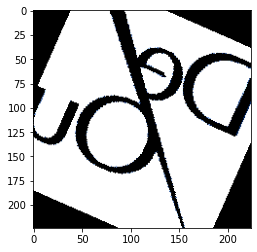

Label: 線條/曲折區塊或其與幾何圖形之組合/重疊(對稱係指整體構圖而言)


In [11]:
# Display image and label.
train_features, train_labels = next(iter(train_loader))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")
img = train_features[0].squeeze().numpy()
img = np.transpose(img, (1, 2, 0))
labels = []
for i, j in enumerate(train_labels[0]):
    if j > 0:
        labels.append(df_labels.columns[i])
label = [labels_dict[i] for i in labels]
plt.imshow(img)
plt.show()
print(f"Label: {' ; '.join(label)}")

In [12]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
def resnet(model,  requires_grad=True):
    if requires_grad == False:
        for param in model.parameters():
            param.requires_grad = False
    num_ftrs = model.fc.in_features 
    model.fc = torch.nn.Linear(num_ftrs, len(df_labels.columns))
    return model

def densenet(model,  requires_grad=True):
    if requires_grad == False:
        for param in model.parameters():
            param.requires_grad = False
    num_ftrs = model.classifier.in_features 
    model.classifier = torch.nn.Linear(num_ftrs, len(df_labels.columns))
    return model

In [13]:

model = resnet(models.resnet152(pretrained=True), requires_grad=True)
# model = densenet(models.densenet201(pretrained=True), requires_grad=True)
model = model.to(device)


In [ ]:
%%time
criterion = torch.nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=5e-5)

num_epochs = 20
liveloss = PlotLosses()
min_loss = 10000

# Train
for epoch in range(num_epochs):
    print("epoch :", epoch)
    logs = {}
    running_loss = 0.0
#     train_accs = []
#     test_accs = []
    test_loss = []
    model.train()
    for times, data in enumerate(tqdm(train_loader)):
        model.train()
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # Zero the parameter gradients
        optimizer.zero_grad()
        # forward + backward + optimize
        outputs = model(inputs)
        outputs = torch.sigmoid(outputs)
#         acc = (outputs.argmax(dim=-1) == labels.to(device)).float().mean()
#         train_accs.append(acc)
        loss = criterion(outputs, labels)
        loss.backward()
        running_loss += loss.item()
        optimizer.step()
        

    logs['train_loss'] = running_loss/times
    
    with torch.no_grad():
        for data in tqdm(test_loader):
            model.eval()
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = torch.sigmoid(outputs)
            loss = criterion(outputs, labels)
            
            test_loss.append(loss.detach().item())
#             acc = (outputs.argmax(dim=-1) == labels.to(device)).float().mean()
#             test_accs.append(acc)


    logs['test_loss'] = sum(test_loss) / len(test_loss)
    
    liveloss.update(logs)
    liveloss.send()
    
    if logs['test_loss'] < min_loss:
        min_loss = logs['test_loss']
        PATH = "resnet152.pt"
        torch.save({
                    'model_state_dict': model.state_dict(),
                    'optimizer_state_dict': optimizer.state_dict(),
                    }, PATH)
        print("save model at epoch: {}".format(epoch))
    else:
        print("didn't save model")
print('Finished Training')

In [ ]:
# PATH = "model.pt"
# torch.save({
#             'model_state_dict': model.state_dict(),
#             'optimizer_state_dict': optimizer.state_dict(),
#             }, PATH)

In [16]:
PATH = "resnet152.pt"
checkpoint = torch.load(PATH)
model = resnet(models.resnet152(pretrained=True), requires_grad=True)
num_ftrs = model.fc.in_features 
model.fc = torch.nn.Linear(num_ftrs, len(df_labels.columns))
model.load_state_dict(checkpoint['model_state_dict'])
model = model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=5e-5)
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])


100%|██████████| 6427/6427 [00:31<00:00, 203.92it/s]



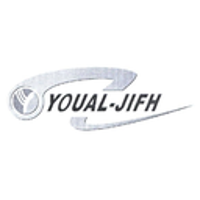
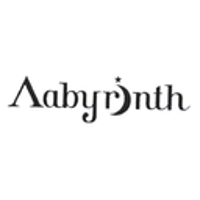
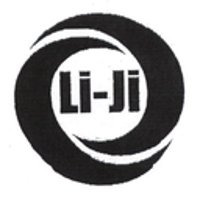
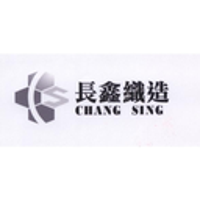
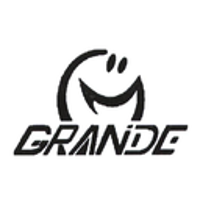
...
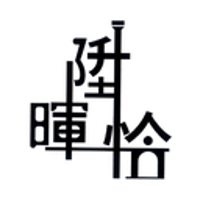
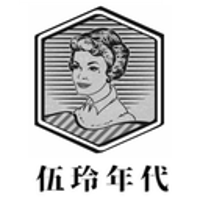
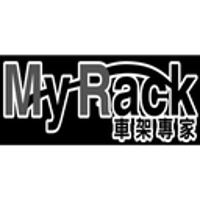
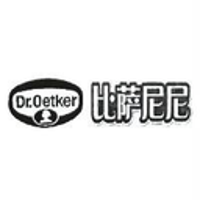
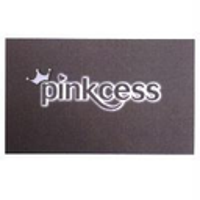

In [17]:
threshold = 0.5
title = []
imgs = []
with torch.no_grad():
    for i, data in enumerate(tqdm(test_loader)):
        model.eval()
        if i % 100 == 1:
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = torch.sigmoid(outputs).cpu()
            outputs = outputs.numpy()
            pred = test_loader.dataset.label_code[(outputs[0])>threshold].tolist()
            if len(pred) == 0:
                pred = [ test_loader.dataset.label_code[np.argmax(outputs[0])]]
            img = Image.open(test_loader.dataset.path[i][0])
            caseno = test_loader.dataset.df_merge.index[i]
            img = img.resize((128,128),Image.ANTIALIAS)
    #             display(img)
            label = [labels_dict[i] for i in pred]
    #             img = inputs.cpu().squeeze().numpy()
    #             img = np.transpose(img, (1, 2, 0))
    #             plt.imshow((img))
    #             plt.show()

    #             print(f"pred labels : {' ; '.join(label)}")
            gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
    #             print(f"ground truth: {' ; '.join([labels_dict[i] for i in gd])}")

            title.append("caseno: {}\nPred Labels : {}\nGround Truth: {}".format(caseno, ' ; '.join(label), ' ; '.join([labels_dict[i] for i in gd])))
            imgs.append(img)
ipyplot.plot_class_representations(imgs, title, img_width=200)

In [18]:
threshold = 0.5
y_pred = []
y_true = []
top1_y_acc = []
top3_y_acc = []
top5_y_acc = []
with torch.no_grad():
    for i, data in enumerate(tqdm(test_loader)):
        model.eval()
        if True:
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)[0]
            
            outputs = torch.sigmoid(outputs).cpu()
            outputs = outputs.numpy()
            
            # binary
            binary_output = (outputs > threshold).astype(int)
            if 1 not in binary_output:
                binary_output[np.argmax(outputs)] = 1
            y_pred.append(binary_output)
            
            #top 1
            top1_index = np.argsort(outputs)[-1:][::-1]
            hit = False
            for index in top1_index:
                if (test_loader.dataset.labels[i]>0).astype(int)[index] > 0:
                    hit = True
            if hit is True:
                top1_y_acc.append(1)
            else:
                top1_y_acc.append(0)
                
            # top 3
            top3_index = np.argsort(outputs)[-3:][::-1]
            hit = False
            for index in top3_index:
                if (test_loader.dataset.labels[i]>0).astype(int)[index] > 0:
                    hit = True
            if hit is True:
                top3_y_acc.append(1)
            else:
                top3_y_acc.append(0)
#             print(outputs)
#             print(np.argsort(outputs)[-3:][::-1])
#             print(max(outputs))
#             print(np.argmax(outputs))
    
            # top 5
            top5_index = np.argsort(outputs)[-5:][::-1]
            hit = False
            for index in top5_index:
                if (test_loader.dataset.labels[i]>0).astype(int)[index] > 0:
                    hit = True
            if hit is True:
                top5_y_acc.append(1)
            else:
                top5_y_acc.append(0)
    
            y_true.append((test_loader.dataset.labels[i]>0).astype(int))

y_pred = np.stack(y_pred, axis=0)
y_true = np.stack(y_true, axis=0)


100%|██████████| 6427/6427 [01:52<00:00, 56.94it/s]


In [17]:
# def Hamming_Loss(y_true, y_pred):
#     temp=0
#     for i in range(y_true.shape[0]):
#         temp += np.size(y_true[i] == y_pred[i]) - np.count_nonzero(y_true[i] == y_pred[i])
#     return temp/(y_true.shape[0] * y_true.shape[1])
# def Accuracy(y_true, y_pred):
#     temp = 0
#     for i in range(y_true.shape[0]):
#         temp += sum(np.logical_and(y_true[i], y_pred[i])) / sum(np.logical_or(y_true[i], y_pred[i]))
#     return temp / y_true.shape[0]
# def Precision(y_true, y_pred):
#     temp = 0
#     for i in range(y_true.shape[0]):
#         if sum(y_true[i]) == 0:
#             continue
#         temp += sum(np.logical_and(y_true[i], y_pred[i]))/ sum(y_true[i])
#     return temp/ y_true.shape[0]
# def Recall(y_true, y_pred):
#     temp = 0
#     for i in range(y_true.shape[0]):
#         if sum(y_pred[i]) == 0:
#             continue
#         temp += sum(np.logical_and(y_true[i], y_pred[i]))/ sum(y_pred[i])
#     return temp/ y_true.shape[0]

# def F1Measure(y_true, y_pred):
#     temp = 0
#     for i in range(y_true.shape[0]):
#         if (sum(y_true[i]) == 0) and (sum(y_pred[i]) == 0):
#             continue
#         temp+= (2*sum(np.logical_and(y_true[i], y_pred[i])))/ (sum(y_true[i])+sum(y_pred[i]))
#     return temp/ y_true.shape[0]

# def evaluation(y_true, y_pred):
#     print(f"Hamming loss :{Hamming_Loss(y_true, y_pred)}")
#     print(f"Accuracy     :{Accuracy(y_true, y_pred)}")
#     print(f"Precision    :{Precision(y_true, y_pred)}")
#     print(f"Recall       :{Recall(y_true, y_pred)}")
#     print(f"F1Measure    :{F1Measure(y_true, y_pred)}")
    
# evaluation(y_true, y_pred)

圖片平均label數  
去掉較少的label & 合併class  

macro & micro average

定義答對: e.g. 兩個label猜到一個
precision & recall 有問題

top 3 : 前三個有碰到正確label就好

每一個 class 都算一個 threshold  maximize f1

試試看新增17大類的label

accuracy 計算有問題 應該會比較大

### TOP-N Accuracy
前 N 個機率最大的output 中包含到任意一個 ground truth 即視為預測正確

In [22]:
def topN():
    print("top 1: {:.3f}".format(sum(top1_y_acc)/len(top1_y_acc)))
    print("top 3: {:.3f}".format(sum(top3_y_acc)/len(top3_y_acc)))
    print("top 5: {:.3f}".format(sum(top5_y_acc)/len(top5_y_acc)))
topN()

top 1: 0.797
top 3: 0.927
top 5: 0.955


## Confusion Matrix

threshold 為 0.5

tp: 預測positive結果正確  
fp: 預測positive結果錯誤  
tn: 預測negative結果正確   
fn: 預測negative結果錯誤  

tp+fp = 預測為positive的數量  
tn+fn = 預測為negative的數量  

tp+tn = 預測正確的數量  
fp+fn = 預測錯誤的數量  

In [23]:
tp = []
tn = []
fp = []
fn = []
for i in range(y_pred.shape[1]):
    pred = y_pred[:,i]
    true = y_true[:,i]

    tp.append(np.logical_and(pred, true).sum())
    
    fp.append(pred.sum()-np.logical_and(pred, true).sum())

    tn.append((pred==true).sum()-np.logical_and(pred, true).sum())


    cnt = 0
    for m, n in zip(y_pred[:,i], y_true[:,i]):
        if m==0 and n==1:
            cnt += 1
    fn.append(cnt)
tp = np.array(tp)
fp = np.array(fp)
tn = np.array(tn)
fn = np.array(fn)

## Macro-average
所有類別先各自計算 recall & precision 再取算術平均
Use macro-averaging score when all classes need to be treated equally to evaluate the overall performance of the classifier with regard to the most frequent class labels.  

In [24]:
def macro():
    accuracy = ((tp+tn)/(tp+fp+tn+fn))
    print("Accuracy : {:.3f}".format(   accuracy.mean()))
    recall = tp/(tp+fn)
    print("Recall   : {:.3f}".format(   recall[~np.isnan(recall)].mean()    ))
    precision = tp/(tp+fp)
    print("Precision: {:.3f}".format(   precision[~np.isnan(precision)].mean()    ))

macro()

Accuracy : 0.990
Recall   : 0.447
Precision: 0.745


<ipython-input-24-22db24a57a9b>:4: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/(tp+fn)
<ipython-input-24-22db24a57a9b>:6: RuntimeWarning: invalid value encountered in true_divide
  precision = tp/(tp+fp)


## Micro-average
Micro-averaging recall scores is sum of true positive for individual classes divided by sum of actual positives for all classes.   
Micro-averaging precision scores is sum of true positive for individual classes divided by sum of predicted positives for all classes  
Use micro-averaging score when there is a need to weight each instance or prediction equally.

In [25]:
def micro():
    print("Recall   : {:.3f}".format(   tp.sum()/(tp.sum() + fn.sum())  ))
    print("Precision: {:.3f}".format(   tp.sum()/(tp.sum() + fp.sum())  ))
micro()

Recall   : 0.642
Precision: 0.758


## Weighted-average
根據各個 class 數量的比例去加權  (比如人類這個類別有 100筆， 非人類的類別有 900筆， 人類的權重為 100/1000 = 0.1)

In [26]:
def weighted():
    weights = y_true.sum(axis=0)/y_true.sum()
    accuracy = ((tp+tn)/(tp+fp+tn+fn))
    print("Accuracy : {:.3f}".format(  np.dot(accuracy, weights)))
    recall = tp/(tp+fn)
    print("Recall : {:.3f}".format(  np.dot(recall[~np.isnan(recall)], weights[~np.isnan(recall)])   ))
    
    precision = tp/(tp+fp)
    print("Precision : {:.3f}".format(  np.dot(precision[~np.isnan(precision)], weights[~np.isnan(precision)])   ))
weighted()

Accuracy : 0.955
Recall : 0.642
Precision : 0.757


<ipython-input-26-92ac9893388d>:5: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/(tp+fn)
<ipython-input-26-92ac9893388d>:8: RuntimeWarning: invalid value encountered in true_divide
  precision = tp/(tp+fp)


## Summary

In [27]:
def summary():
    print("-----top N------")
    topN()
    print("-----Macro-----")
    macro()
    print("-----Micro-----")
    micro()
    print("-----Weighted-----")
    weighted()
summary()

-----top N------
top 1: 0.797
top 3: 0.927
top 5: 0.955
-----Macro-----
Accuracy : 0.990
Recall   : 0.447
Precision: 0.745
-----Micro-----
Recall   : 0.642
Precision: 0.758
-----Weighted-----
Accuracy : 0.955
Recall : 0.642
Precision : 0.757


<ipython-input-24-22db24a57a9b>:4: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/(tp+fn)
<ipython-input-24-22db24a57a9b>:6: RuntimeWarning: invalid value encountered in true_divide
  precision = tp/(tp+fp)
<ipython-input-26-92ac9893388d>:5: RuntimeWarning: invalid value encountered in true_divide
  recall = tp/(tp+fn)
<ipython-input-26-92ac9893388d>:8: RuntimeWarning: invalid value encountered in true_divide
  precision = tp/(tp+fp)


## 問題
* 目前的資料過濾掉圖中有文字的彩色平面部分
* 重複的圖片要怎麼辦

計算column wise 的 presion & recall 

NDCG

篩掉重複圖片:  
pretrain model 倒數第二層  
cosine similarity (L2) 設threshold 去篩

## Get laten vector

### trainloader 記得不要 shuffle

In [19]:
model_no_fc = torch.nn.Sequential(*(list(model.children())[:-1]))
model_no_fc.eval()
model_no_fc.training

False

In [20]:
train_data = train_set(df_labels, df_path, transform=transforms.Compose([
#     transforms.Grayscale(num_output_channels=1),
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
]))
train_loader = torch.utils.data.DataLoader(train_data, batch_size=16,shuffle=False,num_workers=6,pin_memory=True)

laten_vec_train = []
with torch.no_grad():
    for i, (x, y) in enumerate(tqdm(train_loader)):
        x = x.to(device)
        out = model_no_fc(x).cpu()
        out = torch.squeeze(out)
        out = out.numpy()
        
#         y = y.numpy().reshape(-1,1)+1
        
#         print(np.concatenate((out, y), axis=1))
#         print(out.shape)
#         break
#         img_vectors.append(np.concatenate((out, y), axis=1))
        laten_vec_train.append(out)


laten_vec_train = np.vstack(laten_vec_train)

100%|██████████| 12988/12988 [16:00<00:00, 13.52it/s]


In [21]:
imgs = []
laten_vec_test = []
with torch.no_grad():
    for i, data in enumerate(tqdm(test_loader)):
        model.eval()
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        ##laten vector
        out = model_no_fc(inputs).cpu()
        out = torch.squeeze(out)
        out = out.numpy()
        laten_vec_test.append(out)

        img = Image.open(test_loader.dataset.path[i][0])
        img = img.resize((128,128),Image.ANTIALIAS)

        imgs.append(img)
laten_vec_test = np.stack(laten_vec_test)


100%|██████████| 6427/6427 [02:22<00:00, 45.06it/s]


In [28]:
print(laten_vec_train.shape)
print(laten_vec_test.shape)

(207797, 2048)
(6427, 2048)


## k-means

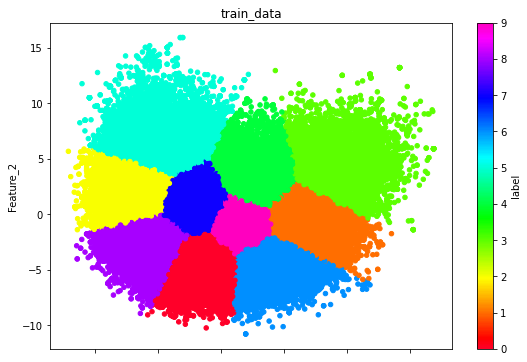

In [27]:
tmp = PCA(2, random_state=4096).fit_transform(laten_vec_train) 
kmeans = KMeans(n_clusters=10, random_state=0).fit(tmp)
df = pd.DataFrame(dict(Feature_1=tmp[:,0], Feature_2=tmp[:,1], label=kmeans.labels_))
df.plot(x="Feature_1", y="Feature_2", kind='scatter', c='label', colormap='gist_rainbow', figsize=(9,6), title='train_data')
# df.plot(x="Feature_1", y="Feature_2", kind='scatter', c='label', colormap='gist_rainbow', figsize=(36,24))
plt.show()

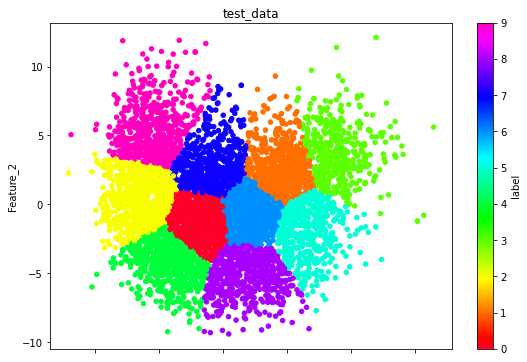

In [28]:
tmp = PCA(2, random_state=4096).fit_transform(laten_vec_test) 
kmeans = KMeans(n_clusters=10, random_state=0).fit(tmp)
df = pd.DataFrame(dict(Feature_1=tmp[:,0], Feature_2=tmp[:,1], label=kmeans.labels_))
df.plot(x="Feature_1", y="Feature_2", kind='scatter', c='label', colormap='gist_rainbow', figsize=(9,6), title='test_data')
# df.plot(x="Feature_1", y="Feature_2", kind='scatter', c='label', colormap='gist_rainbow', figsize=(36,24))
plt.show()

## Retrieval (Cosine similarity)

In [30]:
laten_vec_train.shape

(207797, 2048)

In [31]:
laten_vec_test.shape

(6427, 2048)

In [32]:
def cosine_similarity(x, y):
    a = np.dot(x, y)
    b = np.linalg.norm(x) * np.linalg.norm(y)
    return a/b

### 用一個 test_data laten vector 去檢索( cosine similarity )其他 test data

In [33]:
# for num in range(10):
# #     i = random.randint(0, len(laten_vec_test))
#     i = num
#     similarities = []
#     for v in laten_vec_test:
#         similarities.append(cosine_similarity(laten_vec_test[i], v))
#     index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index
    
    
#     gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
#     print(i, ' ; '.join([labels_dict[i] for i in gd]))
#     display(imgs[i])
#     temp = []
#     for p in test_data.path[index]:
#         img = Image.open(p[0])
#         img = img.resize((128,128),Image.ANTIALIAS)
#         temp.append(img)
        
#     ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
#     print("\n")


### 用一個 test_data laten vector 去檢索( cosine similarity ) train data

0 走獸


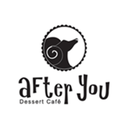


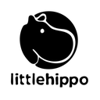
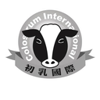
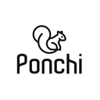
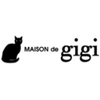
...
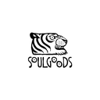
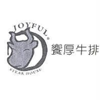
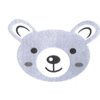
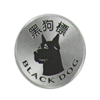
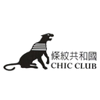



1 走獸


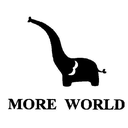


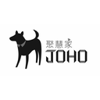
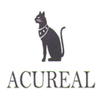
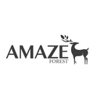
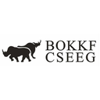
...
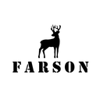
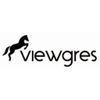
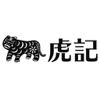
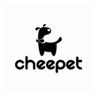
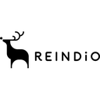



2 圖形化中文 ; 箭號或三角形外觀 ; 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


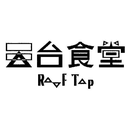


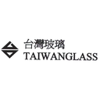
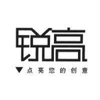
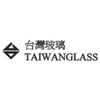
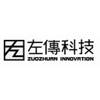
...
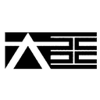
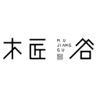
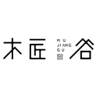
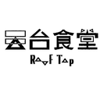
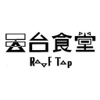



3 五角形以上外觀


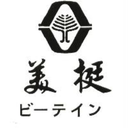


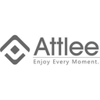
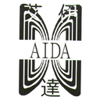
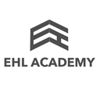
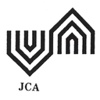
...
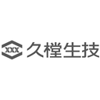
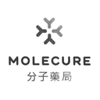
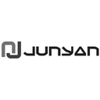
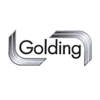
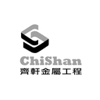



4 男人


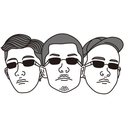


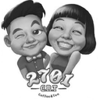
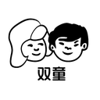
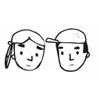
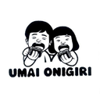
...
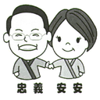
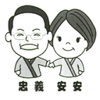
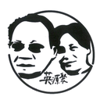
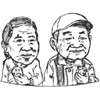
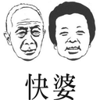



5 圖形化英文


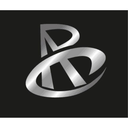


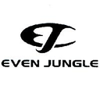
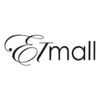
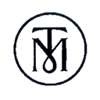
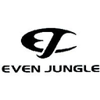
...
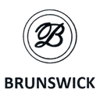
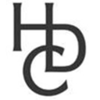
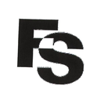
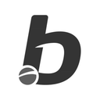
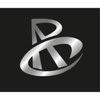



6 花/葉/草


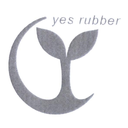


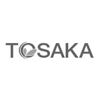
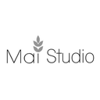
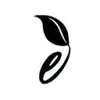
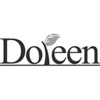
...
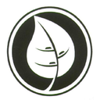
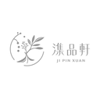
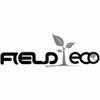
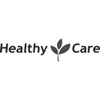
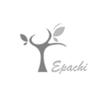



7 小孩/嬰兒


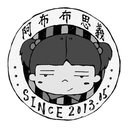


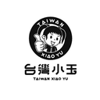
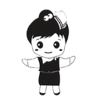
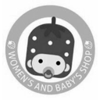
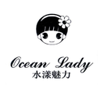
...
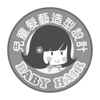
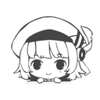
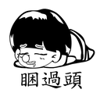
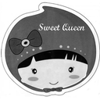
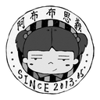



8 四角形外觀


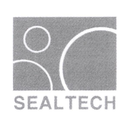


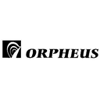
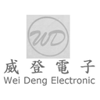
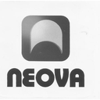
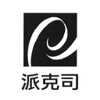
...
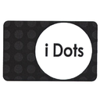
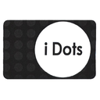
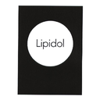
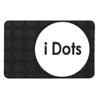
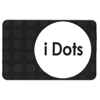



9 走獸 ; 花/葉/草 ; 四角形外觀


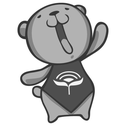


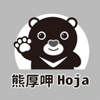
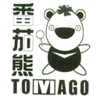
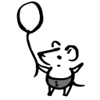
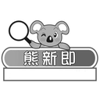
...
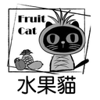
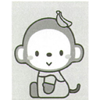
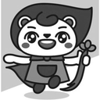
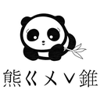
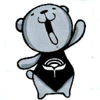

In [34]:
for num in range(10):
#     i = random.randint(0, len(laten_vec_train))
    i = num
    similarities = []
    for v in laten_vec_train:
        similarities.append(cosine_similarity(laten_vec_test[i], v))
    index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index
    
    
    gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
    print(i, ' ; '.join([labels_dict[i] for i in gd]))
    display(imgs[i])
    temp = []
    titles = []
    for p in train_data.path[index]:
        img = Image.open(p[0])
        img = img.resize((128,128),Image.ANTIALIAS)
        temp.append(img)
#     temp.insert(0, imgs[i])
#     titles = list(np.array(similarities)[index])
#     titles.insert(0, str(i) +' ; '.join([labels_dict[i] for i in gd]))

    ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
    print("\n")


10 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


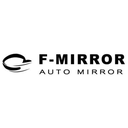


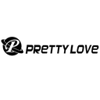
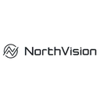
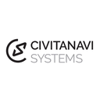
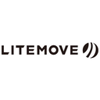
...
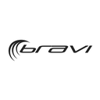
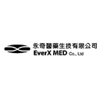
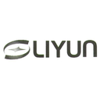
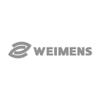
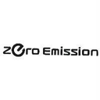



11 四角形外觀 ; 特定形狀圖形


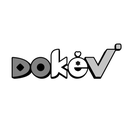


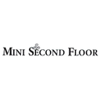
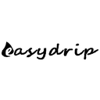
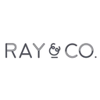
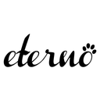
...
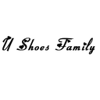
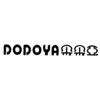
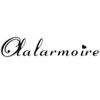
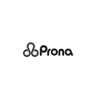
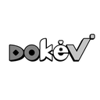



12 水族 ; 外圍合抱圖形(指合抱圖形本身)


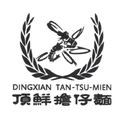


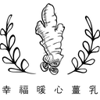
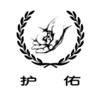
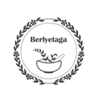
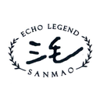
...
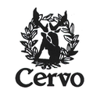
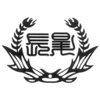
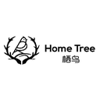
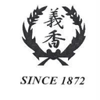
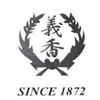



13 圖形化英文


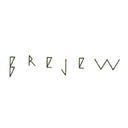


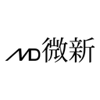
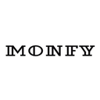
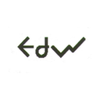
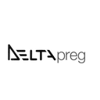
...
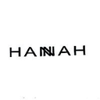
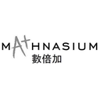
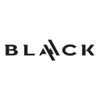
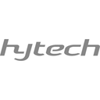
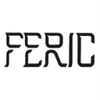



14 擬人化 ; 人體部位 ; 圖形化中文


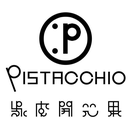


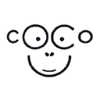
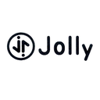
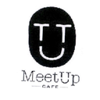
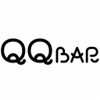
...
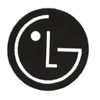
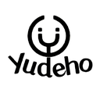
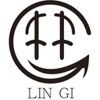
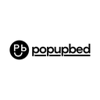
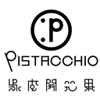



15 圖形化英文


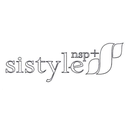


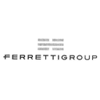
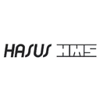
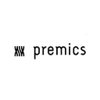
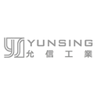
...
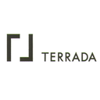
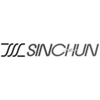
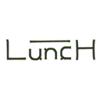
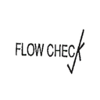
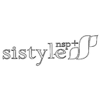



16 圖形化英文


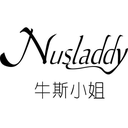


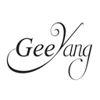
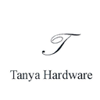
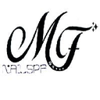
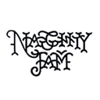
...
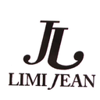
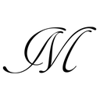
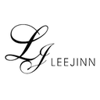
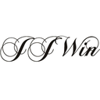
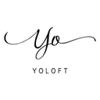



17 天體


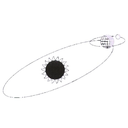


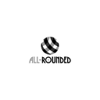
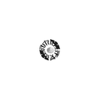
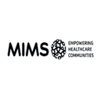
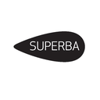
...
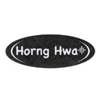
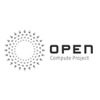
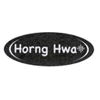
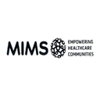
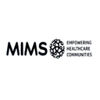



18 飛禽/蝙蝠 ; 文具事務用品(筆.紙.刀片.印章.書.圓規.圖畫.掛畫)


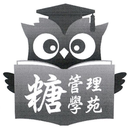


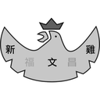
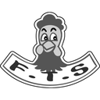
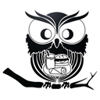
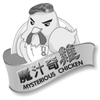
...
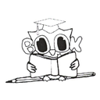
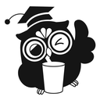
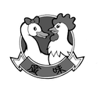
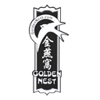
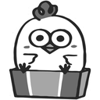



19 盾牌


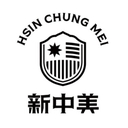


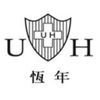
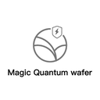
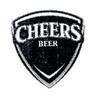
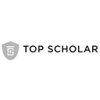
...
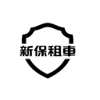
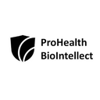
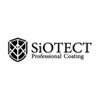
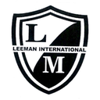
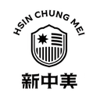

In [35]:
for num in range(10, 20):
#     i = random.randint(0, len(laten_vec_train))
    i = num
    similarities = []
    for v in laten_vec_train:
        similarities.append(cosine_similarity(laten_vec_test[i], v))
    index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index
    
    
    gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
    print(i, ' ; '.join([labels_dict[i] for i in gd]))
    display(imgs[i])
    temp = []
    titles = []
    for p in train_data.path[index]:
        img = Image.open(p[0])
        img = img.resize((128,128),Image.ANTIALIAS)
        temp.append(img)
#     temp.insert(0, imgs[i])
#     titles = list(np.array(similarities)[index])
#     titles.insert(0, str(i) +' ; '.join([labels_dict[i] for i in gd]))

    ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
    print("\n")


20 圖形化英文


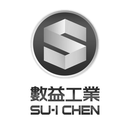


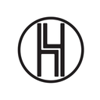
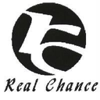
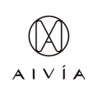
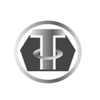
...
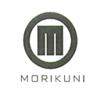
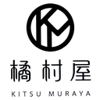
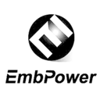
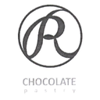
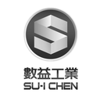



21 裝飾配件 ; 裝飾圖案/緞帶


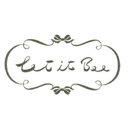


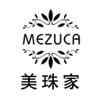
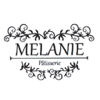
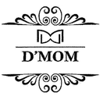
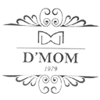
...
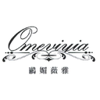
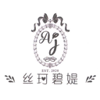
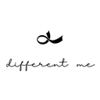
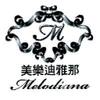
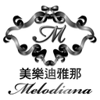



22 四角形外觀


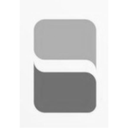


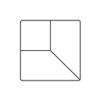
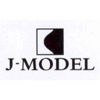
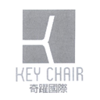
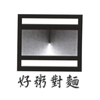
...
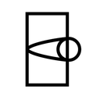
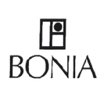
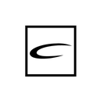
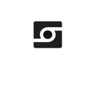
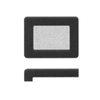



23 建築物之部份


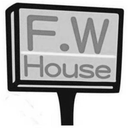


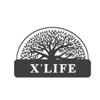
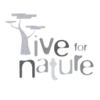
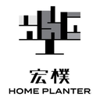
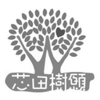
...
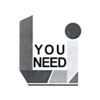
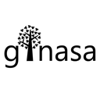
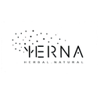
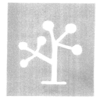
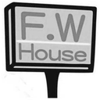



24 圓形外觀 ; 四角形外觀 ; 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


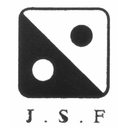


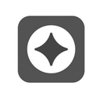
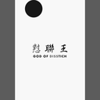
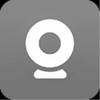
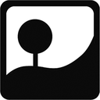
...
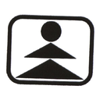
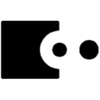
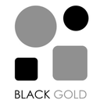
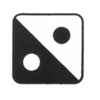
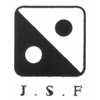



25 走獸 ; 圖形化英文


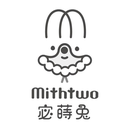


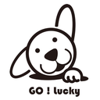
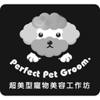
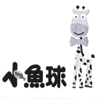
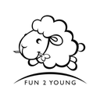
...
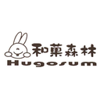
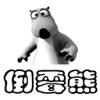
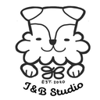
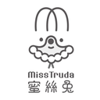
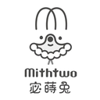



26 擬人化 ; 走獸


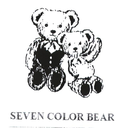


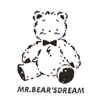
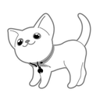
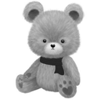
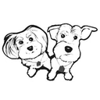
...
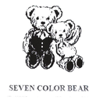
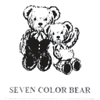
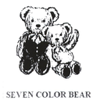
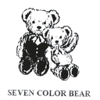
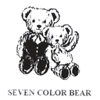



27 帽子


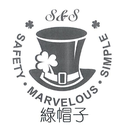


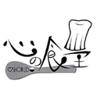
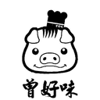
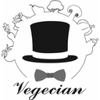
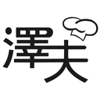
...
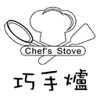
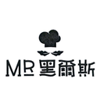
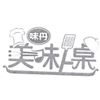
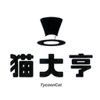
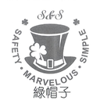



28 廚房設備/器皿(叉.盆.碗.壺.瓶.汽水瓶.鼎.尊.花瓶.杯子.杵臼) ; 特定形狀圖形


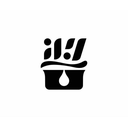


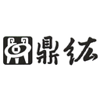
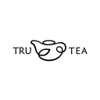
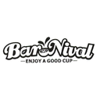
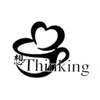
...
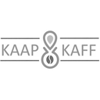
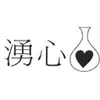
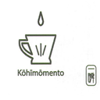
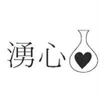
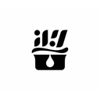



29 小孩/嬰兒 ; 擬人化 ; 廚房設備/器皿(叉.盆.碗.壺.瓶.汽水瓶.鼎.尊.花瓶.杯子.杵臼) ; 帽子


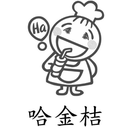


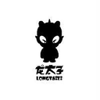
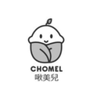
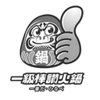
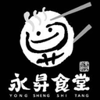
...
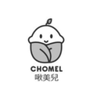
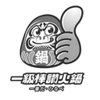
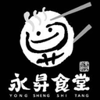
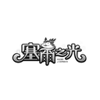
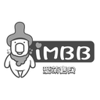

In [36]:
for num in range(20,30):
#     i = random.randint(0, len(laten_vec_train))
    i = num
    similarities = []
    for v in laten_vec_train:
        similarities.append(cosine_similarity(laten_vec_test[i], v))
    index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index
    
    
    gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
    print(i, ' ; '.join([labels_dict[i] for i in gd]))
    display(imgs[i])
    temp = []
    titles = []
    for p in train_data.path[index]:
        img = Image.open(p[0])
        img = img.resize((128,128),Image.ANTIALIAS)
        temp.append(img)
#     temp.insert(0, imgs[i])
#     titles = list(np.array(similarities)[index])
#     titles.insert(0, str(i) +' ; '.join([labels_dict[i] for i in gd]))

    ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
    print("\n")


30 裝飾品(風鈴串.耳環.戒指.鑽石.如意)


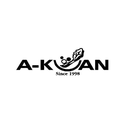


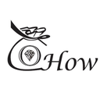
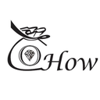
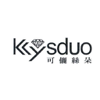
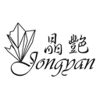
...
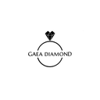
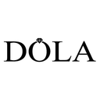
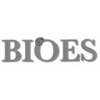
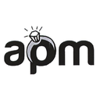
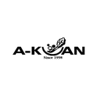



31 裝飾圖案/緞帶 ; 四角形外觀


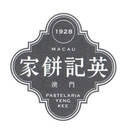


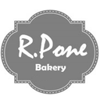
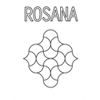
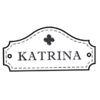
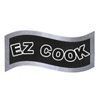
...
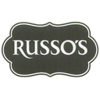
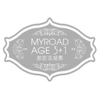
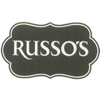
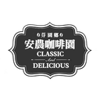
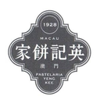



32 圖形化英文 ; 線條/曲折區塊或其與幾何圖形之組合/重疊(對稱係指整體構圖而言)


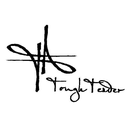


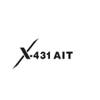
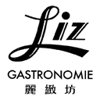
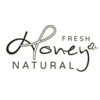
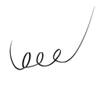
...
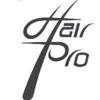
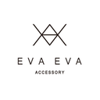
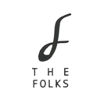
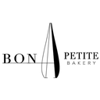
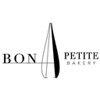



33 樹


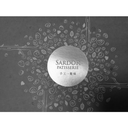


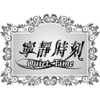
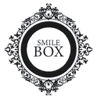
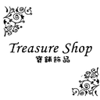
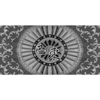
...
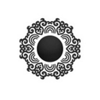
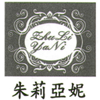
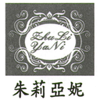
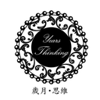
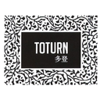



34 神怪 ; 人體部位 ; 下身衣物 ; 手足用品


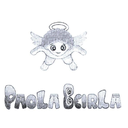


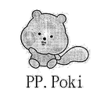
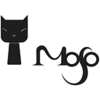
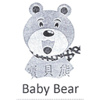
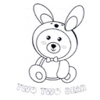
...
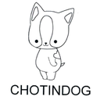
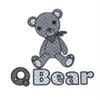
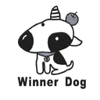
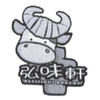
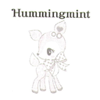



35 人體部位 ; 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


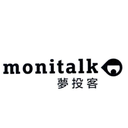


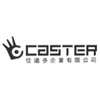
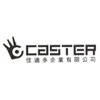
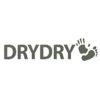
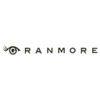
...
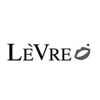
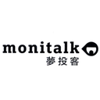
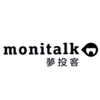
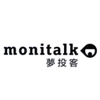
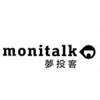



36 圖形化英文


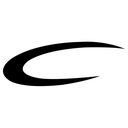


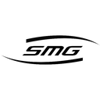
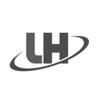
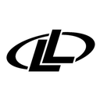
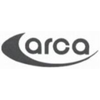
...
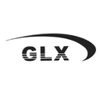
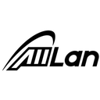
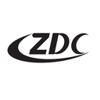
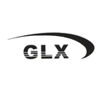
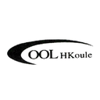



37 男人 ; 光學用品(鏡片.眼鏡.放大鏡.顯微鏡) ; 裝飾配件 ; 圓形外觀


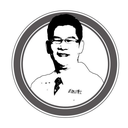


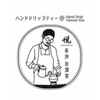
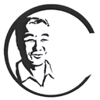
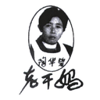
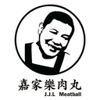
...
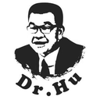
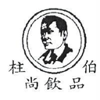
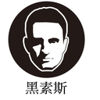
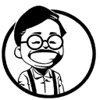
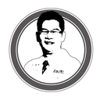



38 飛禽/蝙蝠 ; 圓形外觀 ; 五角形以上外觀


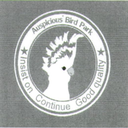


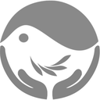
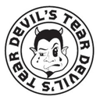
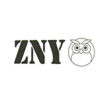
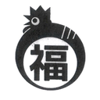
...
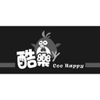
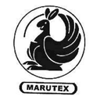
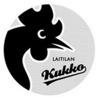
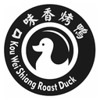
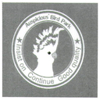



39 圖形化英文


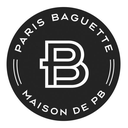


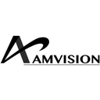
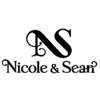
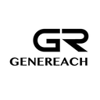
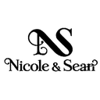
...
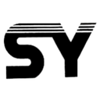
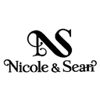
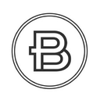
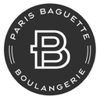
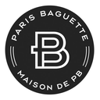

In [37]:
for num in range(30,40):
#     i = random.randint(0, len(laten_vec_train))
    i = num
    similarities = []
    for v in laten_vec_train:
        similarities.append(cosine_similarity(laten_vec_test[i], v))
    index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index
    
    
    gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
    print(i, ' ; '.join([labels_dict[i] for i in gd]))
    display(imgs[i])
    temp = []
    titles = []
    for p in train_data.path[index]:
        img = Image.open(p[0])
        img = img.resize((128,128),Image.ANTIALIAS)
        temp.append(img)
#     temp.insert(0, imgs[i])
#     titles = list(np.array(similarities)[index])
#     titles.insert(0, str(i) +' ; '.join([labels_dict[i] for i in gd]))

    ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
    print("\n")


40 圖形化英文


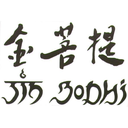


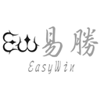
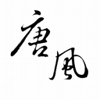
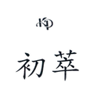
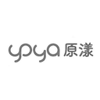
...
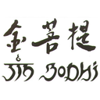
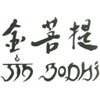
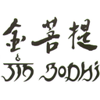
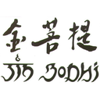
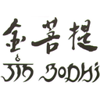



41 小孩/嬰兒 ; 擬人化 ; 根莖果蔬類


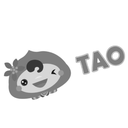


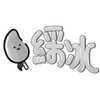
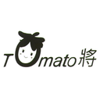
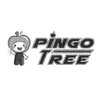
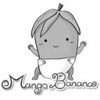
...
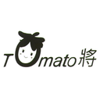
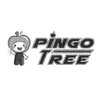
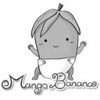
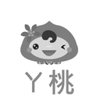
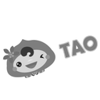



42 假想獸及古代動物


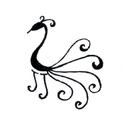


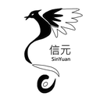
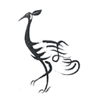
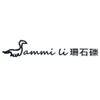
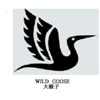
...
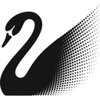
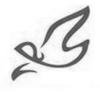
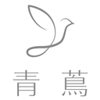
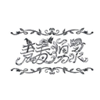
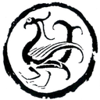



43 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


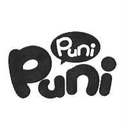


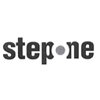
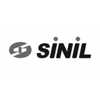
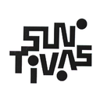
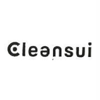
...
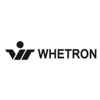
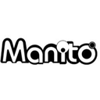
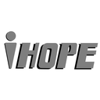
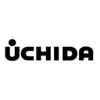
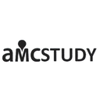



44 花/葉/草


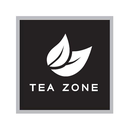


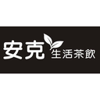
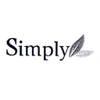
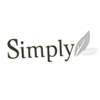
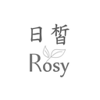
...
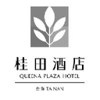
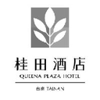
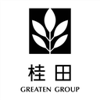
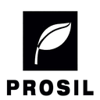
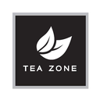



45 糕餅/糖果 ; 圓形外觀


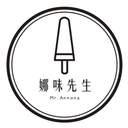


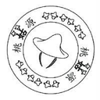
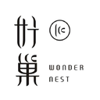
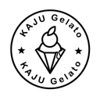
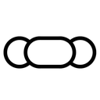
...
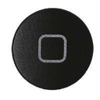
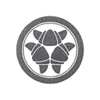
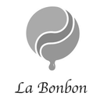
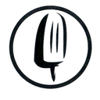
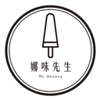



46 線條/曲折區塊或其與幾何圖形之組合/重疊(對稱係指整體構圖而言) ; 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


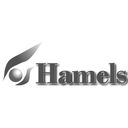


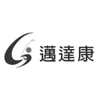
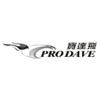
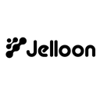
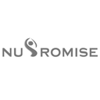
...
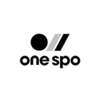
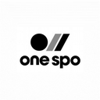
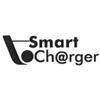
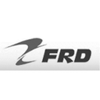
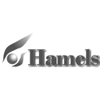



47 圖形化英文


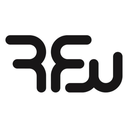


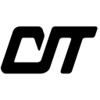
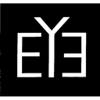
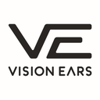
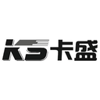
...
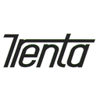
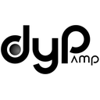
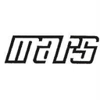
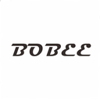
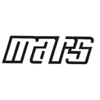



48 圖形化英文 ; 不同幾何形狀組合/重疊或其他不規則圖形(不包含線條)


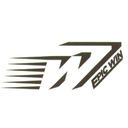


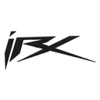
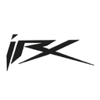
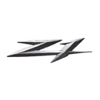
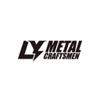
...
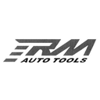
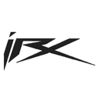
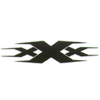
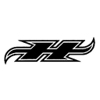
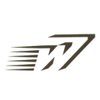



49 四角形外觀 ; 五角形以上外觀


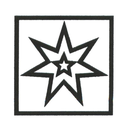


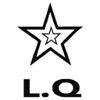
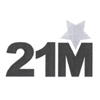
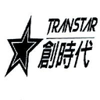
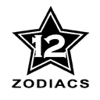
...
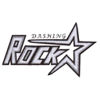
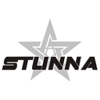
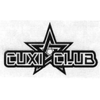
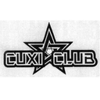
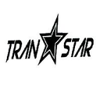

In [38]:
for num in range(40, 50):
#     i = random.randint(0, len(laten_vec_train))
    i = num
    similarities = []
    for v in laten_vec_train:
        similarities.append(cosine_similarity(laten_vec_test[i], v))
    index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index
    
    
    gd = test_loader.dataset.label_code[test_loader.dataset.labels[i]>0]
    print(i, ' ; '.join([labels_dict[i] for i in gd]))
    display(imgs[i])
    temp = []
    titles = []
    for p in train_data.path[index]:
        img = Image.open(p[0])
        img = img.resize((128,128),Image.ANTIALIAS)
        temp.append(img)
#     temp.insert(0, imgs[i])
#     titles = list(np.array(similarities)[index])
#     titles.insert(0, str(i) +' ; '.join([labels_dict[i] for i in gd]))

    ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
    print("\n")


In [39]:
def image_loader(image_name):
    
    loader = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
    image = Image.open(image_name).convert('L').convert('RGB')
    image = loader(image).float()
    image = image.clone().detach()
    image = image.unsqueeze(0)
    return image



def single_img_retrieve(img_path):
    img = image_loader(img_path)
    img = img.to(device)
    out = model_no_fc(img).cpu()
    out = torch.squeeze(out)
    out = out.detach().numpy()

    similarities = []
    for v in laten_vec_train:
        similarities.append(cosine_similarity(out, v))
    index = np.argsort(similarities)[-20:]  # Returns the indices that would sort an array. 取倒數20個也就是前20大的index



    img = Image.open(img_path)
    img = img.resize((128,128),Image.ANTIALIAS)
    display(img)
    temp = []

    for p in train_data.path[index]:
        img = Image.open(p[0])
        img = img.resize((128,128),Image.ANTIALIAS)
        temp.append(img)


    ipyplot.plot_class_representations(temp, np.array(similarities)[index], img_width=100)
    


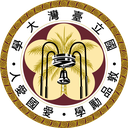


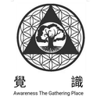
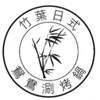
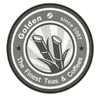
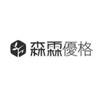
...
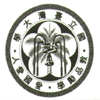
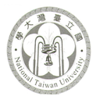
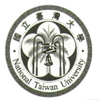
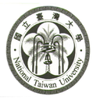
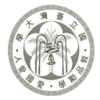

In [40]:
single_img_retrieve('/home/slimon/ntu.jpg')

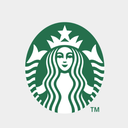


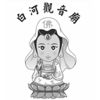
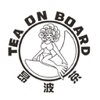
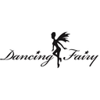
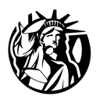
...
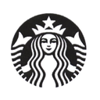
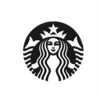
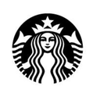
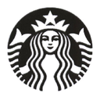
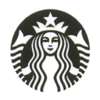

In [41]:
single_img_retrieve('/home/slimon/starbucks.jpg')

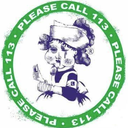


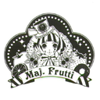
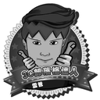
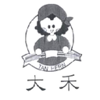
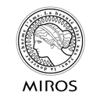
...
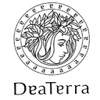
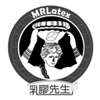
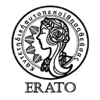
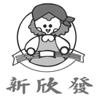
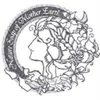

In [42]:
single_img_retrieve('/home/slimon/nurse.jpg')

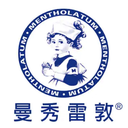


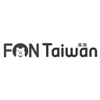
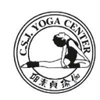
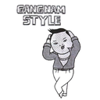
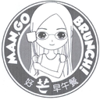
...
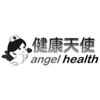
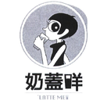
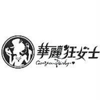
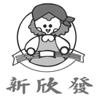
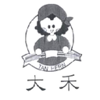

In [43]:
single_img_retrieve('/home/slimon/nurse_1.jpeg')

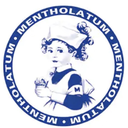


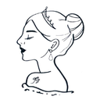
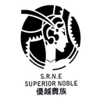
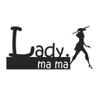
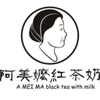
...
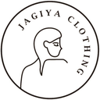
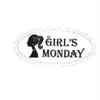
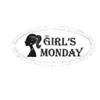
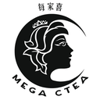
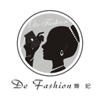

In [44]:
single_img_retrieve('/home/slimon/nurse_2.jpg')

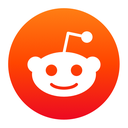


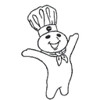
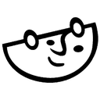
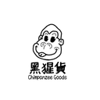
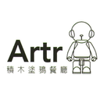
...
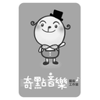
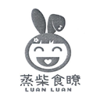
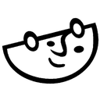
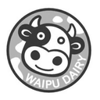
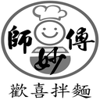

In [45]:
single_img_retrieve('/home/slimon/reddit.jpg')

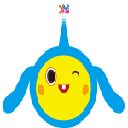


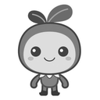
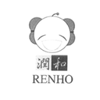
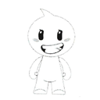
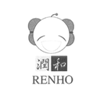
...
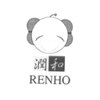
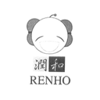
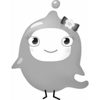
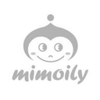
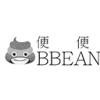

In [46]:
single_img_retrieve('/home/slimon/ximake.jpg')

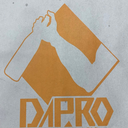


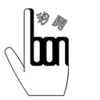
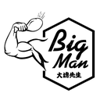
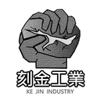
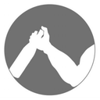
...
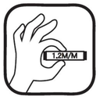
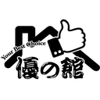
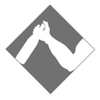
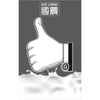
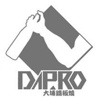

In [47]:
single_img_retrieve('/home/slimon/大埔1.jpg')

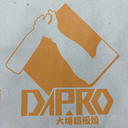


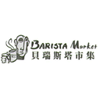
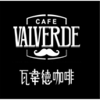
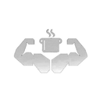
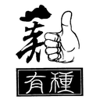
...
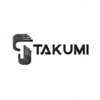
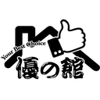
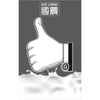
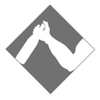
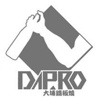

In [48]:
single_img_retrieve('/home/slimon/大埔2.jpg')

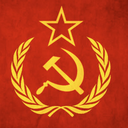


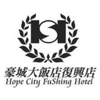
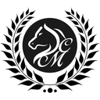
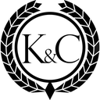
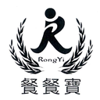
...
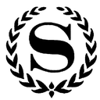
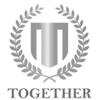
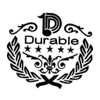
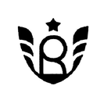
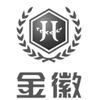

In [49]:
single_img_retrieve('/home/slimon/soviet.jpg')